In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import umap
import torch
import torch.nn as nn
import torch.nn.functional as F
import gc
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

import os
os.environ["PYTORCH_CUDA_ALLOC_CONF"] = "max_split_size_mb:512"
os.chdir('../IConNet/')
print(os.getcwd())

/home/linh/projects/IConNet


In [3]:
from IConNet.acov.audio_vqvae import VqVaeClsLoss
from IConNet.trainer.train_torch import Trainer, get_dataloader
from IConNet.acov.model import SCB8 as SCB
from omegaconf import OmegaConf as ocf

import pandas as pd
import IPython.display as ipd
import seaborn as sns

from IConNet.acov.visualize import (
    visualize_speech_codebook, visualize_embedding_umap,
    get_embedding_color_v2
)

In [4]:
dataset_name = 'ravdess'
log_dir = f'../scb9_models/{dataset_name}/'
data_dir = "../data/data_preprocessed/"
experiment_prefix = "scb9"

dataset_config_path = f'config/dataset/{dataset_name}.yaml'
dataset_config = ocf.load(dataset_config_path)
print(dataset_config)

sr = 16000
batch_size = 4
in_channels = 1
num_segments = 8
out_channels = num_segments*batch_size
embedding_dim = 1023
num_embeddings = 384
cls_dim = 512
downsampling = 8
commitment_cost = 0.1
learning_rate = 1e-3
num_tokens_per_second = 16
max_num_tokens = 256
num_classes = 4
num_training_updates = 1000
log_interval = 100
test_interval = 100

{'name': 'ravdess', 'dataset_class': 'WaveformDataset', 'root': 'ravdess/', 'audio_dir': 'full_release/', 'feature_dir': 'preprocessing/', 'label_name': 'label_emotion_key', 'feature_name': 'audio16k', 'num_classes': 8, 'label_values': ['neu', 'cal', 'hap', 'sad', 'ang', 'fea', 'dis', 'sur'], 'classnames': ['neu', 'cal', 'hap', 'sad', 'ang', 'fea', 'dis', 'sur'], 'target_labels': ['ang', 'neu', 'sad', 'hap']}


In [5]:
import glob
dt = []
for i, f in enumerate(glob.glob(f"{log_dir}val_result*")):
    d = {'filename': f}
    r = torch.load(f)
    keys = list(r.keys())[:6]
    for k in keys:
        d[k] = r[k]
    dt.append(d)
df = pd.DataFrame(dt)
df

,filename,epoch,step,loss,val_acc,val_correct,val_total
0,../scb9_models/ravdess/val_result.epoch=71.ste...,71,7051,147.892670,tensor(0.3333),tensor(9),27
1,../scb9_models/ravdess/val_result.epoch=57.ste...,57,5651,88.731651,tensor(0.3333),tensor(9),27
2,../scb9_models/ravdess/val_result.epoch=22.ste...,22,2151,619.614258,tensor(0.3333),tensor(9),27
3,../scb9_models/ravdess/val_result.epoch=15.ste...,15,1451,9.745774,tensor(0.3333),tensor(9),27
4,../scb9_models/ravdess/val_result.epoch=72.ste...,72,7151,21.143642,tensor(0.6667),tensor(18),27
...,...,...,...,...,...,...,...
96,../scb9_models/ravdess/val_result.epoch=48.ste...,48,4751,1085.801392,tensor(0.3333),tensor(9),27
97,../scb9_models/ravdess/val_result.epoch=99.ste...,99,9851,64.299019,tensor(0.3333),tensor(9),27
98,../scb9_models/ravdess/val_result.epoch=46.ste...,46,4551,1557.066650,tensor(0.6667),tensor(18),27
99,../scb9_models/ravdess/val_result.epoch=9.step...,9,851,64.753357,tensor(0.),tensor(0),27


In [6]:
df['val_acc'] = df['val_acc'].apply(lambda x: x.item())
df['val_correct'] = df['val_correct'].apply(lambda x: x.item())
df.sort_values(by='step', inplace=True, ignore_index=True)

In [7]:
result_e3 = torch.load(
    '../scb9_models/ravdess/val_result.epoch=3.step=251.loss=8.053.val_acc=0.000.pt')
result_e3.keys()

dict_keys(['epoch', 'step', 'loss', 'val_acc', 'val_correct', 'val_total', 'codebook', 'logits', 'latents', 'ypreds', 'ytrues', 'is_correct'])

In [8]:
result_e3['latents']

tensor([[[-0.0000e+00, -0.0000e+00,  0.0000e+00,  ..., -0.0000e+00,
          -0.0000e+00, -0.0000e+00],
         [-0.0000e+00, -0.0000e+00, -0.0000e+00,  ..., -0.0000e+00,
          -0.0000e+00, -0.0000e+00],
         [-0.0000e+00, -0.0000e+00,  0.0000e+00,  ..., -0.0000e+00,
          -0.0000e+00, -0.0000e+00],
         ...,
         [-0.0000e+00, -0.0000e+00, -0.0000e+00,  ...,  0.0000e+00,
          -0.0000e+00,  0.0000e+00],
         [-0.0000e+00, -0.0000e+00,  0.0000e+00,  ...,  0.0000e+00,
          -0.0000e+00, -0.0000e+00],
         [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  ...,  0.0000e+00,
           0.0000e+00,  0.0000e+00]],

        [[ 2.4046e-06,  1.0603e-06, -4.1089e-06,  ...,  2.2172e-06,
           5.2850e-06,  1.3916e-06],
         [ 5.7772e-06,  7.6695e-07,  1.1959e-06,  ...,  1.7558e-06,
           3.1963e-06, -4.5782e-07],
         [ 4.1633e-06,  9.2787e-07,  2.1076e-06,  ...,  1.5488e-06,
           6.0925e-07, -1.4511e-06],
         ...,
         [ 0.0000e+00,  0

In [9]:
result_e3['latents'].shape

torch.Size([27, 8342, 384])

In [10]:
16*12

192

In [11]:
# label: noise=0, voiced=1
selected_filters_idx_with_label = [
    [0, 1], [2, 1], [16, 0], [18, 0], [22, 1],
    [23, 0], [28, 0], [37, 1], [43, 1], [57, 1],
    [65, 0], [77, 0], [79, 1], [123, 0], [127, 1],
    [129, 1], [181, 1], [192+72, 1], [192+77, 1], [192+78, 1],
    [192+79, 0], [192+105, 1], [192+135, 1], [192+137, 1], [192+96, 1],
    [192+64, 1], [192+39, 0], [192+116, 1], [192+130, 0], [192+131, 0]
]

In [12]:
selected_filters_dict = {}
for i, l in selected_filters_idx_with_label:
    selected_filters_dict[i] = "voice" if l==1 else "noise"
selected_filters_dict

{0: 'voice',
 2: 'voice',
 16: 'noise',
 18: 'noise',
 22: 'voice',
 23: 'noise',
 28: 'noise',
 37: 'voice',
 43: 'voice',
 57: 'voice',
 65: 'noise',
 77: 'noise',
 79: 'voice',
 123: 'noise',
 127: 'voice',
 129: 'voice',
 181: 'voice',
 264: 'voice',
 269: 'voice',
 270: 'voice',
 271: 'noise',
 297: 'voice',
 327: 'voice',
 329: 'voice',
 288: 'voice',
 256: 'voice',
 231: 'noise',
 308: 'voice',
 322: 'noise',
 323: 'noise'}

In [17]:
# voice: 20, noise: 10
selected_filters_idx = list(selected_filters_dict.keys())

In [ ]:
#3 get energy envelope before taking mean!!!

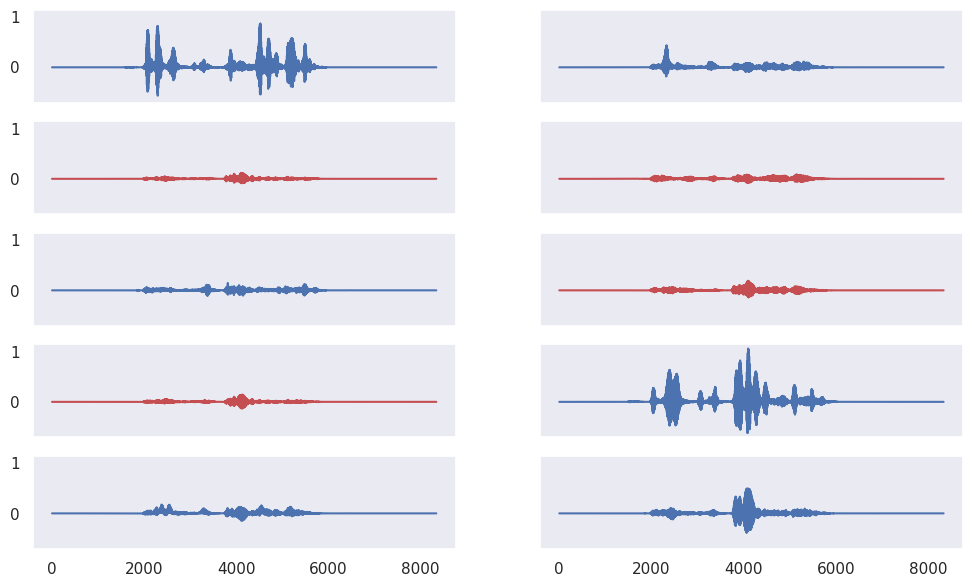

In [27]:
fig, axes = plt.subplots(5, 2, figsize=(12,7), sharex=True, sharey=True)
axes = axes.ravel()
for i, ax in enumerate(axes):
    idx = selected_filters_idx[i]
    color = 'b' if selected_filters_dict[idx]=='voice' else 'r'
    ax.plot(result_e3['latents'][1, :, idx], color=color)

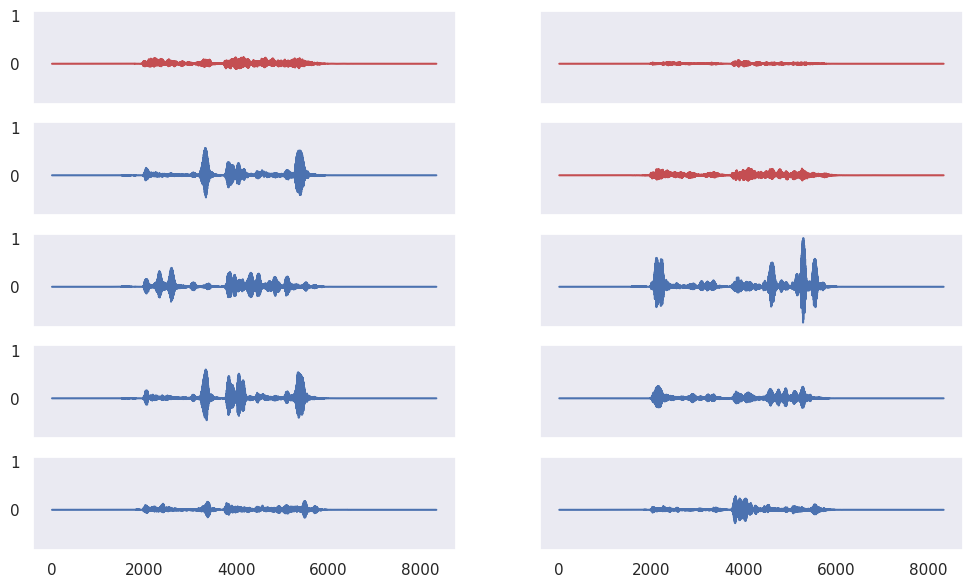

In [28]:
fig, axes = plt.subplots(5, 2, figsize=(12,7), sharex=True, sharey=True)
axes = axes.ravel()
for i, ax in enumerate(axes):
    idx = selected_filters_idx[10+i]
    color = 'b' if selected_filters_dict[idx]=='voice' else 'r'
    ax.plot(result_e3['latents'][1, :, idx], color=color)

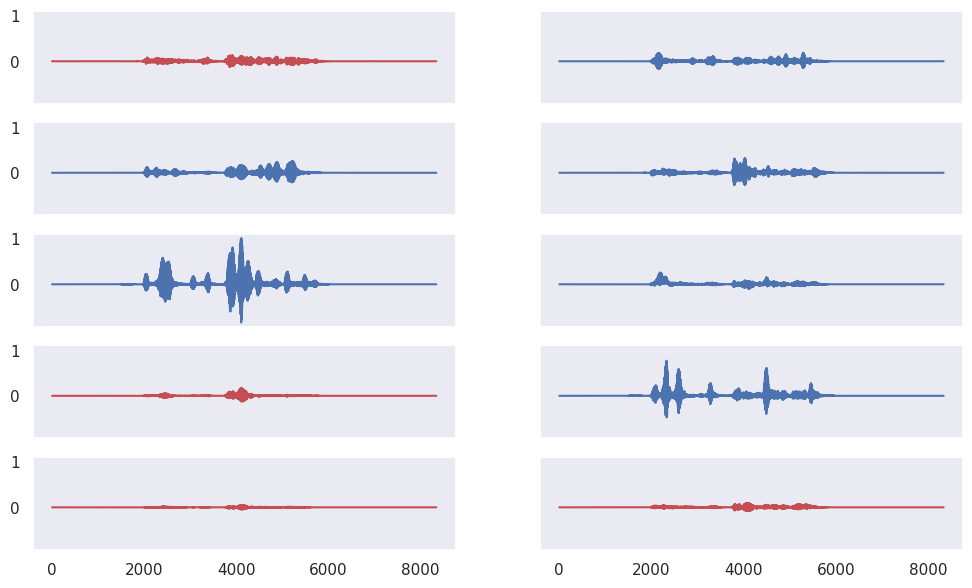

In [29]:
fig, axes = plt.subplots(5, 2, figsize=(12,7), sharex=True, sharey=True)
axes = axes.ravel()
for i, ax in enumerate(axes):
    idx = selected_filters_idx[20+i]
    color = 'b' if selected_filters_dict[idx]=='voice' else 'r'
    ax.plot(result_e3['latents'][1, :, idx], color=color)

In [21]:
result_e3['is_correct']

tensor([False, False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False])

In [24]:
result_e3['latents'].mean(dim=1, keepdim=True).shape

torch.Size([27, 1, 384])

In [25]:
torch.topk(result_e3['latents'].mean(dim=1)[0], k=50)

torch.return_types.topk(
values=tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0.]),
indices=tensor([251, 263, 262, 261, 260, 259, 258, 257, 256, 255, 254, 253, 252, 264,
        250, 249, 248, 247, 246, 245, 244, 243, 242, 241, 207, 276, 287, 286,
        285, 284, 283, 282, 281, 280, 279, 278, 277, 240, 275, 274, 273, 272,
        271, 270, 269, 268, 267, 266, 265, 209]))

In [26]:
torch.topk(result_e3['latents'].mean(dim=1)[1], k=50)

torch.return_types.topk(
values=tensor([0.0291, 0.0254, 0.0238, 0.0235, 0.0217, 0.0214, 0.0207, 0.0197, 0.0186,
        0.0183, 0.0181, 0.0167, 0.0154, 0.0140, 0.0130, 0.0112, 0.0094, 0.0092,
        0.0092, 0.0084, 0.0078, 0.0077, 0.0076, 0.0072, 0.0071, 0.0071, 0.0071,
        0.0068, 0.0068, 0.0062, 0.0062, 0.0062, 0.0059, 0.0057, 0.0056, 0.0055,
        0.0054, 0.0054, 0.0054, 0.0053, 0.0053, 0.0052, 0.0051, 0.0051, 0.0050,
        0.0048, 0.0046, 0.0046, 0.0046, 0.0045]),
indices=tensor([224,   0,  37, 219, 288,  75, 129, 321, 246, 336,  96, 308, 181, 134,
         79, 127, 198, 240,  99,  88,   2, 171,  43, 351, 256,  72, 264, 315,
        167, 327, 124, 117,  57, 313, 228,  41,  65, 114, 233, 370, 166, 269,
        205, 329, 123, 297, 238, 307, 110, 113]))

In [30]:
e3_latent_mean = result_e3['latents'].mean(dim=1)

In [32]:
for i in range(10):
    print(torch.topk(e3_latent_mean[i], k=20))

torch.return_types.topk(
values=tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
indices=tensor([255, 249, 245, 244, 243, 242, 241, 246, 253, 254, 252, 256, 257, 258,
        259, 260, 261, 262, 263, 251]))
torch.return_types.topk(
values=tensor([0.0291, 0.0254, 0.0238, 0.0235, 0.0217, 0.0214, 0.0207, 0.0197, 0.0186,
        0.0183, 0.0181, 0.0167, 0.0154, 0.0140, 0.0130, 0.0112, 0.0094, 0.0092,
        0.0092, 0.0084]),
indices=tensor([224,   0,  37, 219, 288,  75, 129, 321, 246, 336,  96, 308, 181, 134,
         79, 127, 198, 240,  99,  88]))
torch.return_types.topk(
values=tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
indices=tensor([255, 249, 245, 244, 243, 242, 241, 246, 253, 254, 252, 256, 257, 258,
        259, 260, 261, 262, 263, 251]))
torch.return_types.topk(
values=tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
indices=tensor([255, 249, 245, 244, 24

In [33]:
e3_latent_mean.sum(dim=-1)

tensor([0.0000, 1.2779, 0.0000, 0.0000, 1.2779, 0.0000, 0.0000, 1.2779, 0.0000,
        0.0000, 1.2779, 0.0000, 0.0000, 1.2779, 0.0000, 0.0000, 1.2779, 0.0000,
        0.0000, 1.2779, 0.0000, 0.0000, 1.2779, 0.0000, 0.0000, 1.2779, 0.0000])

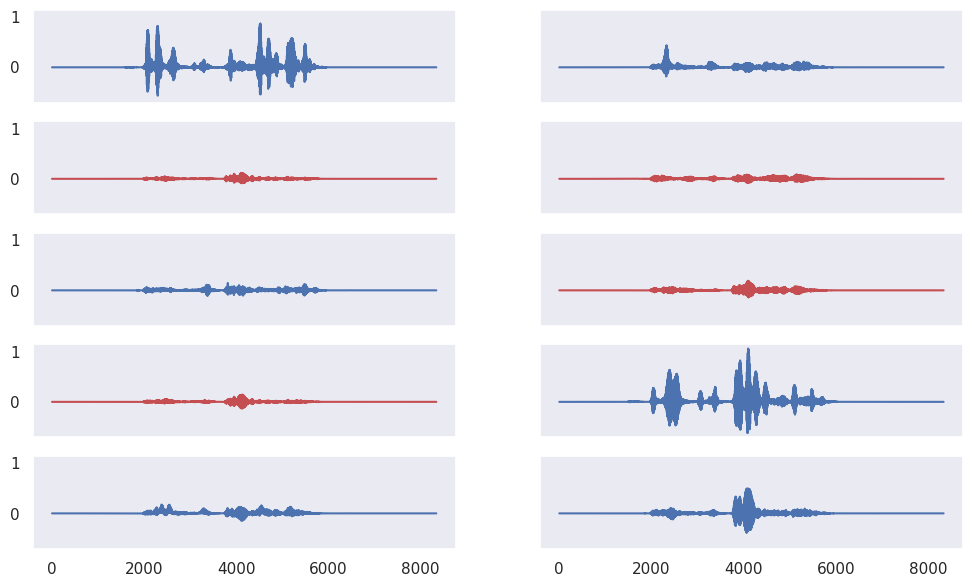

In [34]:
sample = 4
fig, axes = plt.subplots(5, 2, figsize=(12,7), sharex=True, sharey=True)
axes = axes.ravel()
for i, ax in enumerate(axes):
    idx = selected_filters_idx[i]
    color = 'b' if selected_filters_dict[idx]=='voice' else 'r'
    ax.plot(result_e3['latents'][sample, :, idx], color=color)

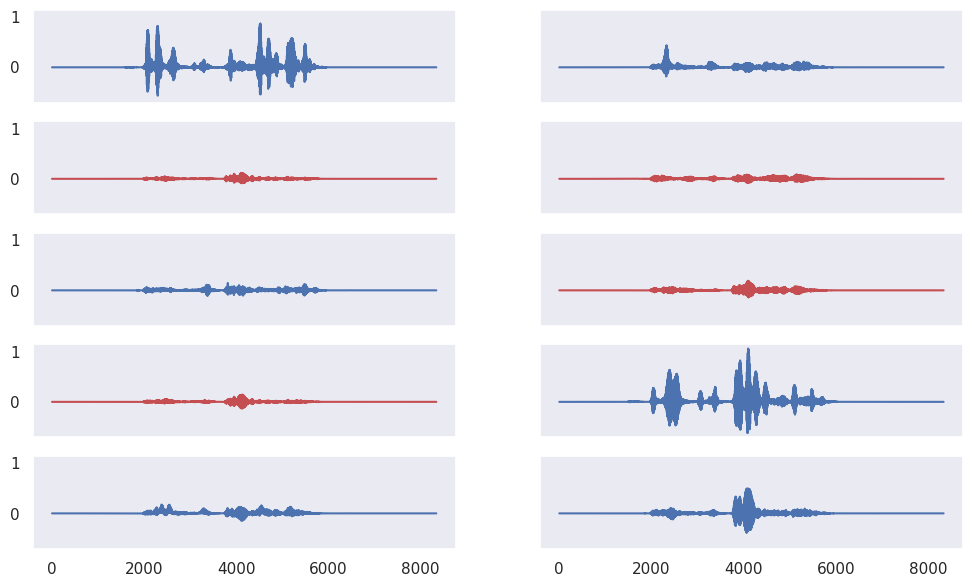

In [35]:
sample = 7
fig, axes = plt.subplots(5, 2, figsize=(12,7), sharex=True, sharey=True)
axes = axes.ravel()
for i, ax in enumerate(axes):
    idx = selected_filters_idx[i]
    color = 'b' if selected_filters_dict[idx]=='voice' else 'r'
    ax.plot(result_e3['latents'][sample, :, idx], color=color)

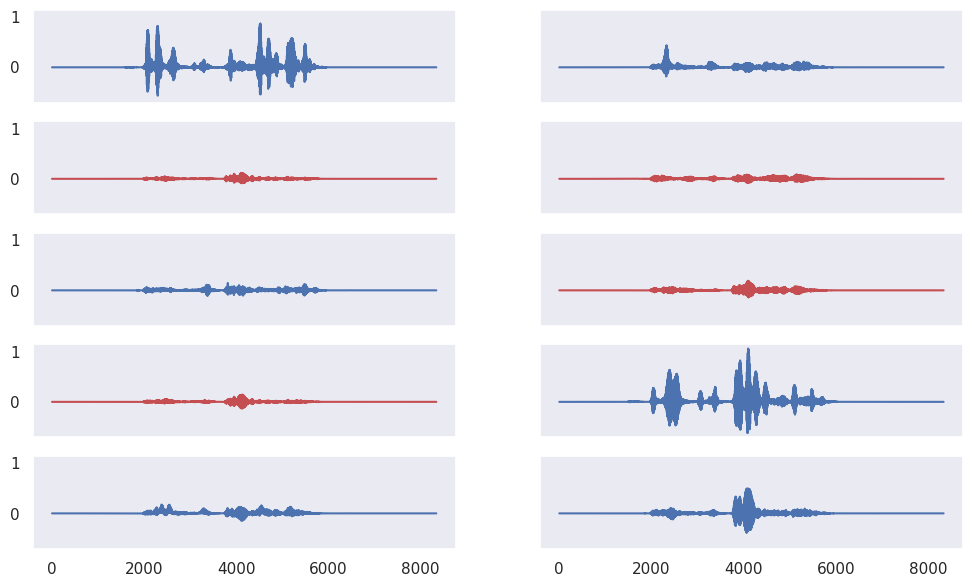

In [36]:
sample = 10
fig, axes = plt.subplots(5, 2, figsize=(12,7), sharex=True, sharey=True)
axes = axes.ravel()
for i, ax in enumerate(axes):
    idx = selected_filters_idx[i]
    color = 'b' if selected_filters_dict[idx]=='voice' else 'r'
    ax.plot(result_e3['latents'][sample, :, idx], color=color)

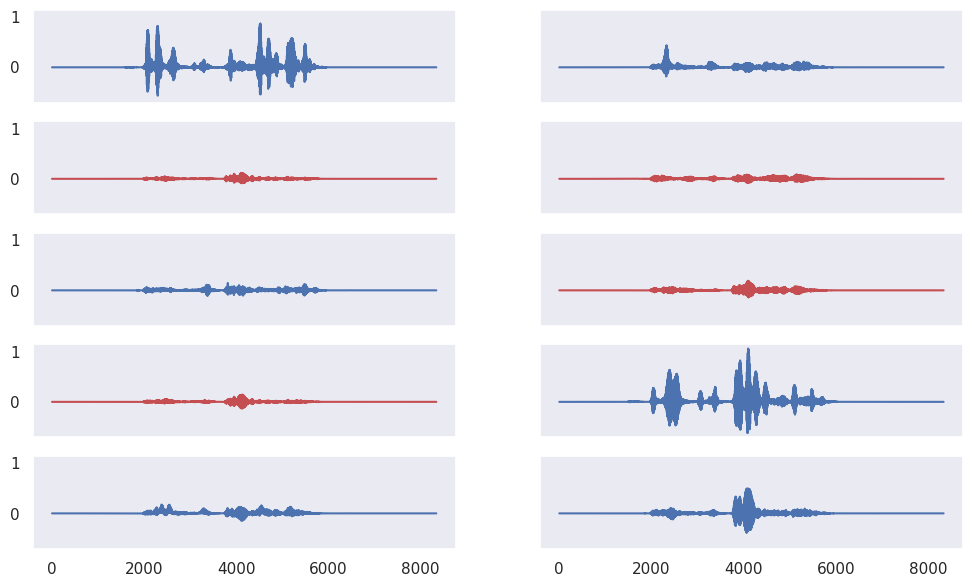

In [37]:
sample = 13
fig, axes = plt.subplots(5, 2, figsize=(12,7), sharex=True, sharey=True)
axes = axes.ravel()
for i, ax in enumerate(axes):
    idx = selected_filters_idx[i]
    color = 'b' if selected_filters_dict[idx]=='voice' else 'r'
    ax.plot(result_e3['latents'][sample, :, idx], color=color)

In [83]:
for i in range(30):
    print(result_e3['latents'][1, :, selected_filters_idx[i]].amax())

tensor(0.8693)
tensor(0.4346)
tensor(0.1163)
tensor(0.0858)
tensor(0.1464)
tensor(0.1892)
tensor(0.1410)
tensor(1.0574)
tensor(0.1742)
tensor(0.4921)
tensor(0.1306)
tensor(0.0762)
tensor(0.5658)
tensor(0.1494)
tensor(0.3927)
tensor(1.0125)
tensor(0.5972)
tensor(0.2534)
tensor(0.1818)
tensor(0.2788)
tensor(0.1316)
tensor(0.1871)
tensor(0.2537)
tensor(0.3168)
tensor(1.0127)
tensor(0.2563)
tensor(0.1691)
tensor(0.7689)
tensor(0.0454)
tensor(0.0955)


In [38]:
train_loader, test_loader, batch_size = get_dataloader(
    dataset_config, data_dir, batch_size=batch_size)

In [56]:
X, Y = [], []
for ii in range(9):
    x, y = next(iter(test_loader))
    X.append(x)
    Y.append(y)
X = torch.concat(X, dim=0)
Y = torch.concat(Y, dim=0)
print(X.shape, Y.shape)

torch.Size([27, 1, 66733]) torch.Size([27])


In [41]:
labels =  ['ang', 'neu', 'sad', 'hap']

In [40]:
del train_loader

In [43]:
from IConNet.acov.audio_viz import display_audio_list, compute_pitch

In [59]:
X_np = X.numpy().squeeze()

In [60]:
X_np.shape

(27, 66733)

RAVDESS ang 0
RAVDESS hap 1
RAVDESS neu 2
RAVDESS ang 3
RAVDESS hap 4
RAVDESS neu 5
RAVDESS ang 6
RAVDESS hap 7
RAVDESS neu 8
RAVDESS ang 9
RAVDESS hap 10
RAVDESS neu 11
RAVDESS ang 12
RAVDESS hap 13
RAVDESS neu 14
RAVDESS ang 15
RAVDESS hap 16
RAVDESS neu 17
RAVDESS ang 18
RAVDESS hap 19
RAVDESS neu 20
RAVDESS ang 21
RAVDESS hap 22
RAVDESS neu 23
RAVDESS ang 24
RAVDESS hap 25
RAVDESS neu 26


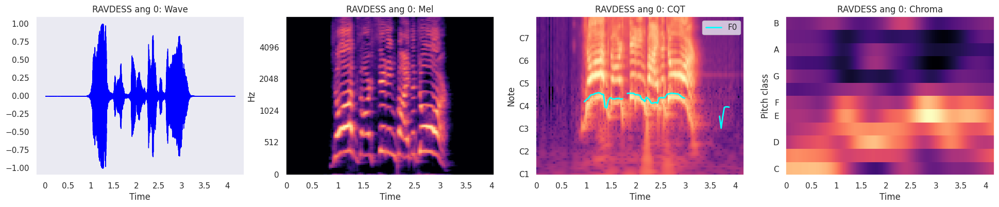

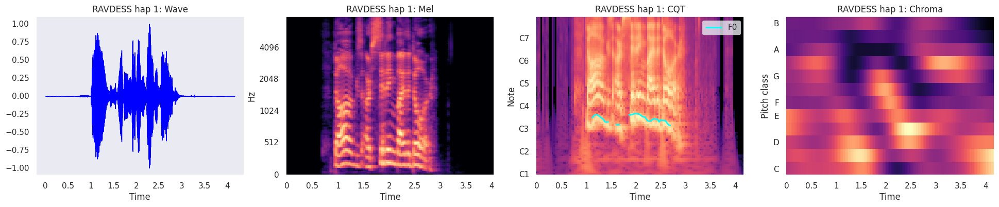

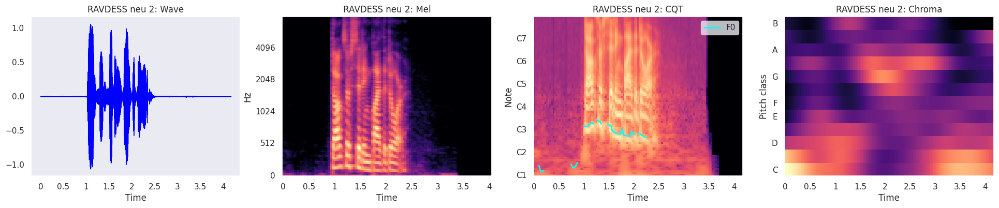

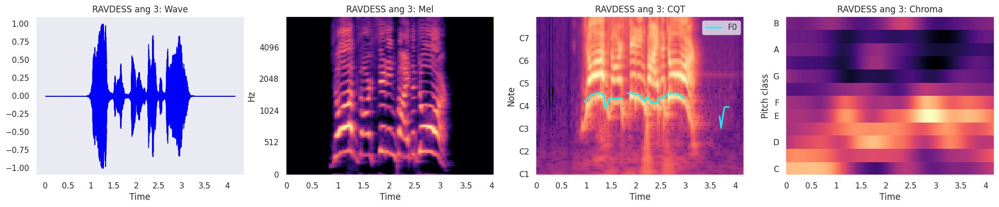

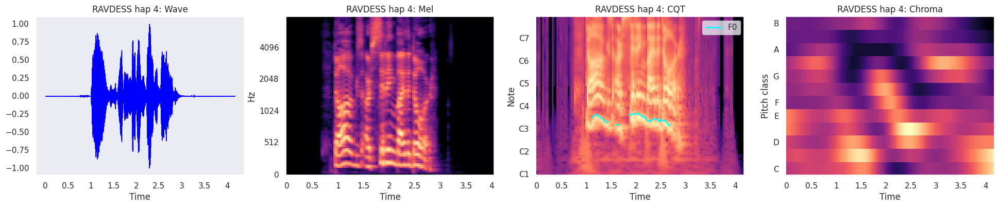

...

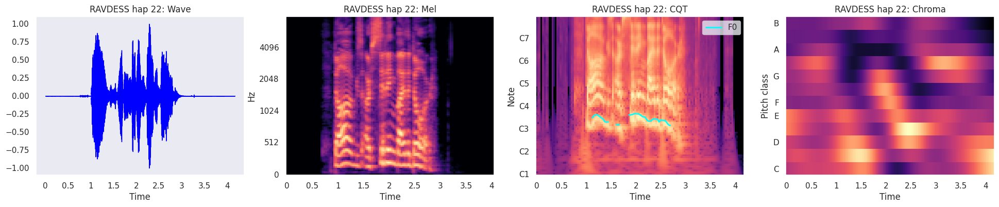

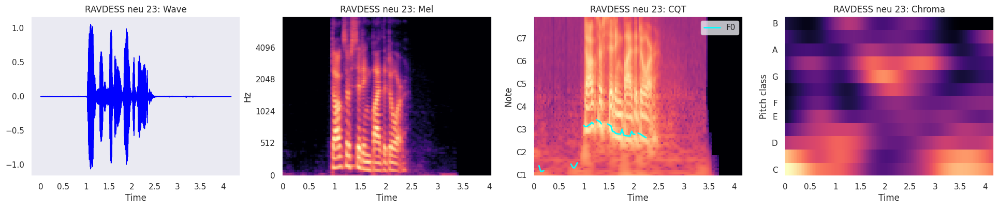

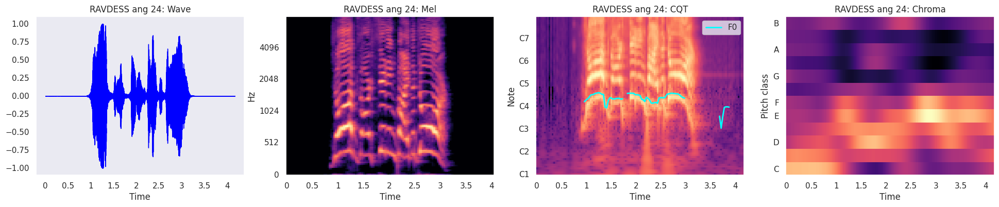

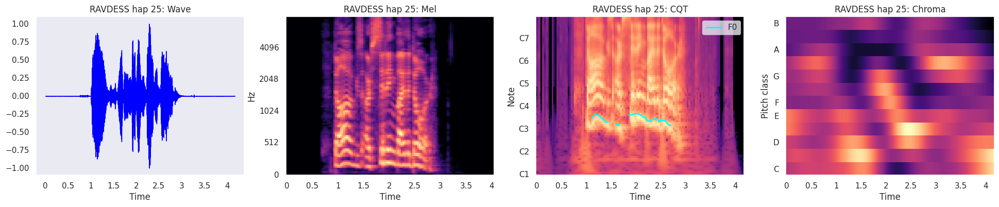

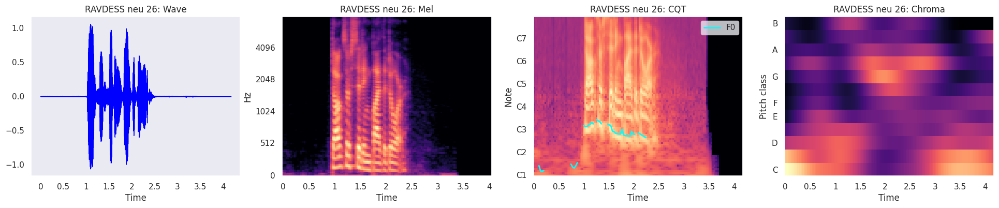

In [61]:
players = []
for ii in range(27):
    players += display_audio_list(X_np, [ii], f"RAVDESS {labels[Y[ii]]} ")
for p in players:
    ipd.display(p)

In [48]:
Y[0]

tensor([0, 3, 1])

In [50]:
file_label_path = f'{data_dir}ravdess/preprocessing/ravdess.label_emotion_key.npy'
label_data = np.load(file_label_path, allow_pickle=True)

In [51]:
label_data

array(['neu', 'neu', 'neu', ..., 'sur', 'sur', 'sur'], dtype=object)

In [54]:
x, y = next(iter(test_loader))
print(x.shape, y.shape)
y

torch.Size([3, 1, 66733]) torch.Size([3])


tensor([0, 3, 1])

In [63]:
from torch.utils.data import Subset

In [67]:
val_loader = Subset(test_loader.dataset, torch.arange(27))

In [68]:
for x, y in val_loader:
    X.append(x)
    Y.append(y)
X = np.concatenate(X, dim=0)
Y = np.concatenate(Y, dim=0)
X_np = X.numpy().squeeze()
players = []
for ii in range(27):
    players += display_audio_list(X_np, [ii], f"RAVDESS {labels[Y[ii]]} ")
for p in players:
    ipd.display(p)

TypeError: expected Tensor as element 0 in argument 0, but got numpy.ndarray

In [72]:
X[0].shape

(1, 66733)

RAVDESS ang 0
RAVDESS hap 1
RAVDESS neu 2
RAVDESS sad 3
RAVDESS neu 4
RAVDESS ang 5
RAVDESS neu 6
RAVDESS hap 7
RAVDESS ang 8
RAVDESS sad 9
RAVDESS ang 10
RAVDESS ang 11
RAVDESS neu 12
RAVDESS sad 13
RAVDESS hap 14
RAVDESS ang 15
RAVDESS sad 16
RAVDESS hap 17
RAVDESS sad 18
RAVDESS sad 19
RAVDESS hap 20
RAVDESS sad 21
RAVDESS neu 22
RAVDESS ang 23
RAVDESS sad 24
RAVDESS hap 25
RAVDESS sad 26


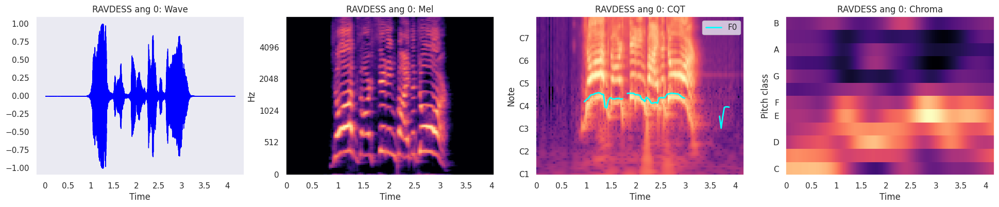

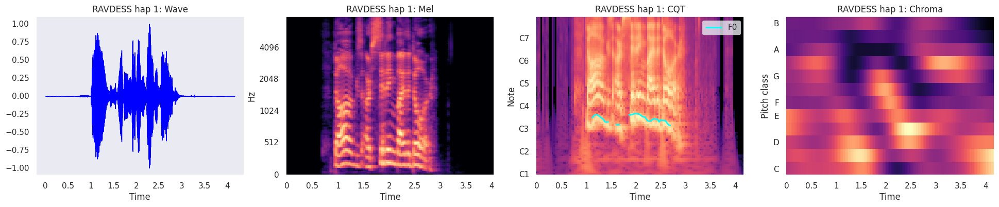

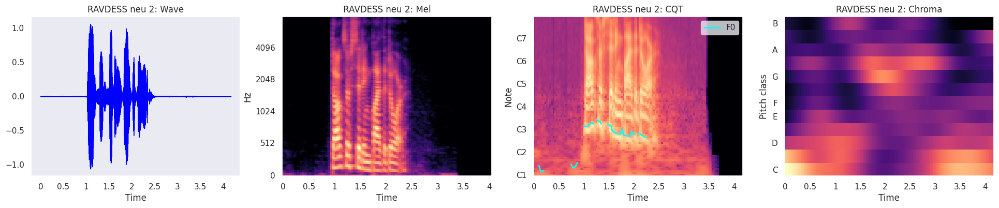

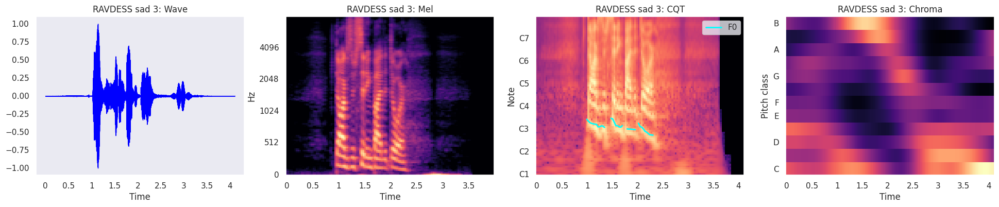

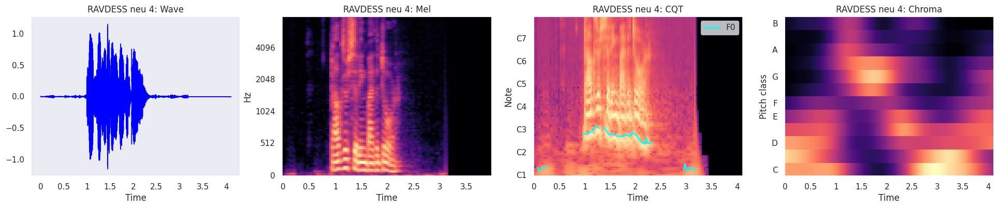

...

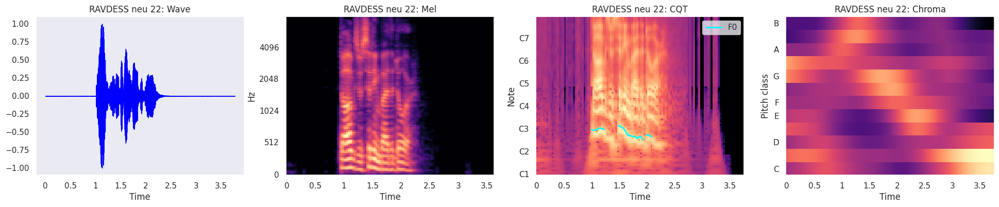

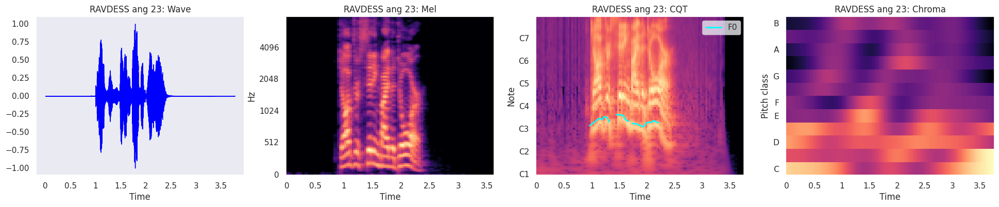

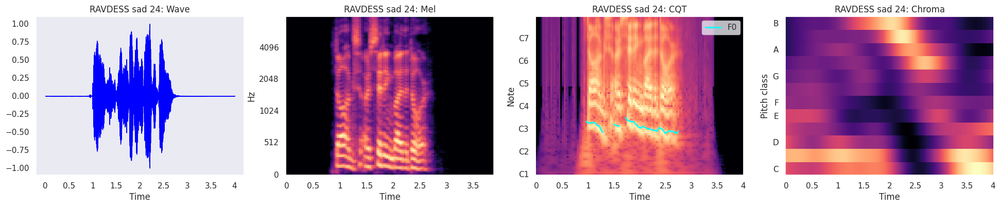

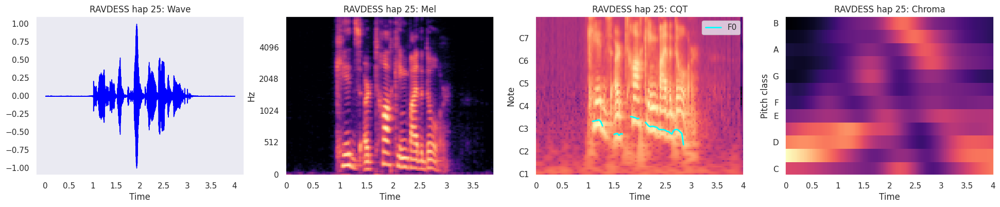

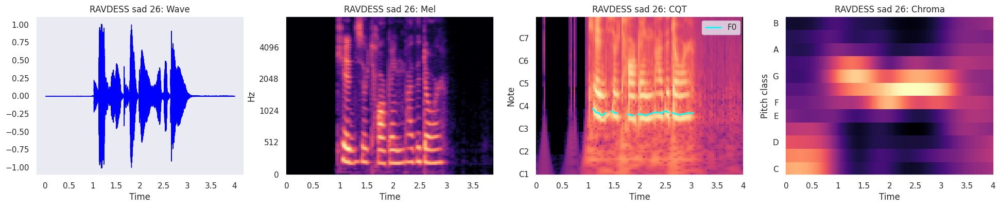

In [79]:
data_generator = iter(test_loader)
X, Y = [], []
for ii in range(9):
    x, y = next(data_generator)
    X.extend(x.squeeze().numpy())
    Y.extend(y.squeeze().numpy())
players = []
for ii in range(27):
    players += display_audio_list(X, [ii], f"RAVDESS {labels[Y[ii]]} ")
for p in players:
    ipd.display(p)

In [81]:
del val_loader

In [82]:
from einops import reduce, rearrange, repeat

In [93]:
def get_env(X, kz=128, s=64, ds=4, norm=False):
    env = F.avg_pool1d(
            F.avg_pool1d(
                X[None,None,:].abs(), 
            kernel_size=kz, stride=s),
        kernel_size=ds, stride=ds).squeeze()
    if norm:
        env /= env.amax(dim=-1)
    return env

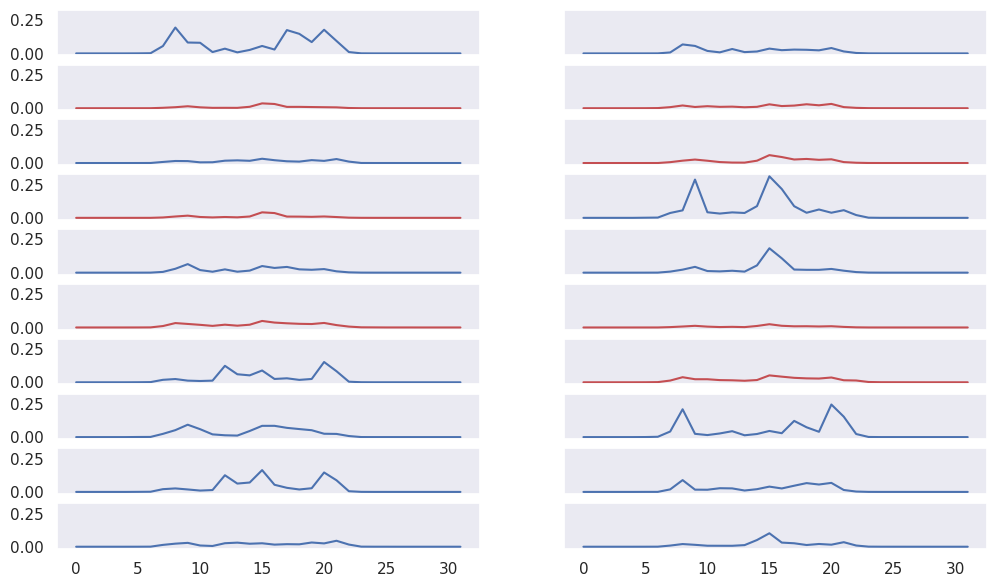

In [94]:
sample = 1
fig, axes = plt.subplots(10, 2, figsize=(12,7), sharex=True, sharey=True)
axes = axes.ravel()
for i, ax in enumerate(axes):
    idx = selected_filters_idx[i]
    color = 'b' if selected_filters_dict[idx]=='voice' else 'r'
    env = get_env(result_e3['latents'][sample, :, idx])
    ax.plot(env, color=color)

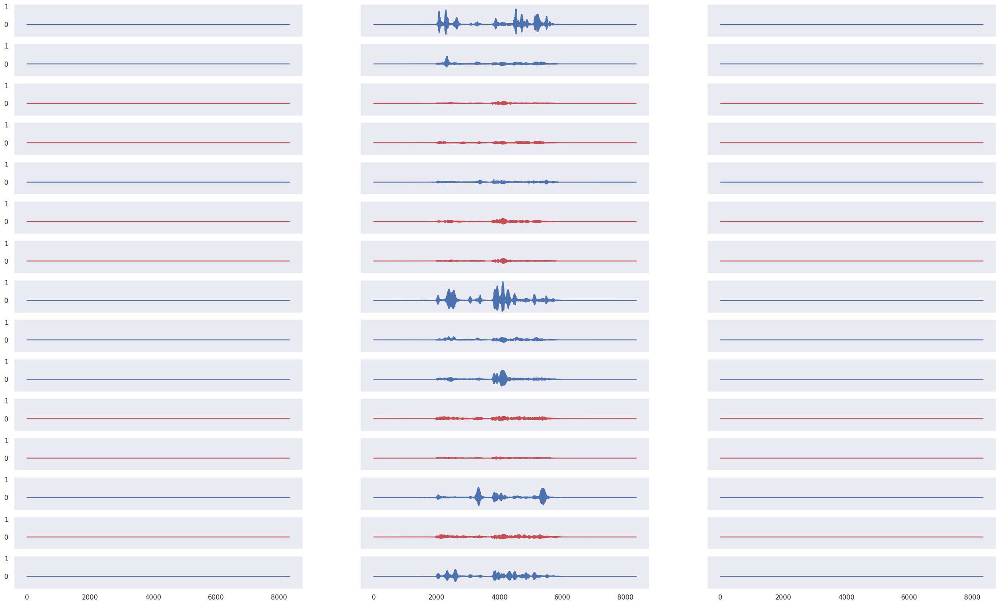

In [100]:
samples = [0, 1, 2]
fig, axes = plt.subplots(15, 3, figsize=(30,18), sharex=True, sharey=True)
# axes = axes.ravel()
for i, ax in enumerate(axes):
    idx = selected_filters_idx[i]
    color = 'b' if selected_filters_dict[idx]=='voice' else 'r'

    j = 0
    x = result_e3['latents'][samples[j], :, idx]
    ax[j].plot(x, color=color)

    j += 1
    x = result_e3['latents'][samples[j], :, idx]
    ax[j].plot(x, color=color)

    j += 1
    x = result_e3['latents'][samples[j], :, idx]
    ax[j].plot(x, color=color)

In [102]:
codebook = result_e3['codebook'].numpy()

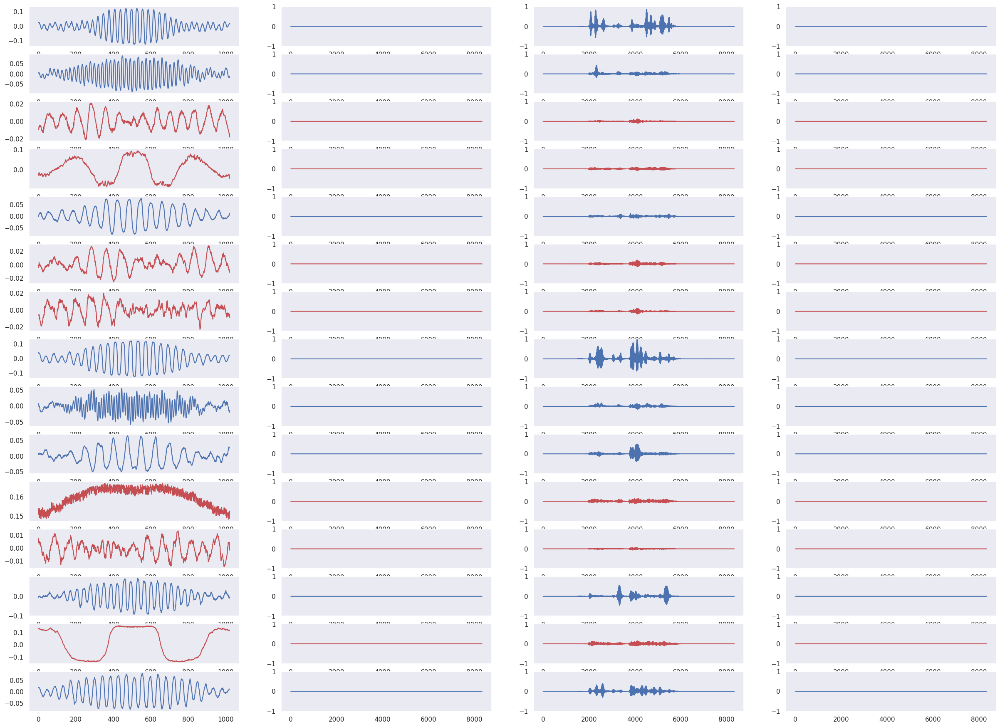

In [111]:
samples = [0, 1, 2]
fig, axes = plt.subplots(15, 4, figsize=(30,22))
# axes = axes.ravel()
for i, ax in enumerate(axes):
    idx = selected_filters_idx[i]
    color = 'b' if selected_filters_dict[idx]=='voice' else 'r'

    j = 0
    x = codebook[idx, :]
    ax[j].plot(x, color=color)

    j += 1
    x = result_e3['latents'][samples[j-1], :, idx]
    ax[j].plot(x, color=color)
    ax[j].set_ylim(-1,1)

    j += 1
    x = result_e3['latents'][samples[j-1], :, idx]
    ax[j].plot(x, color=color)
    ax[j].set_ylim(-1,1)

    j += 1
    x = result_e3['latents'][samples[j-1], :, idx]
    ax[j].plot(x, color=color)
    ax[j].set_ylim(-1,1)

In [101]:
log_img_dir = f'../scb9_models/latent_img/'

In [112]:
fig.savefig(f'{log_img_dir}epoch3_0.png', bbox_inches='tight')

In [118]:
def save_latent_plots(filename, epoch, frequency=5, dpi=100):
    if epoch % frequency == 0:
        data_dict = torch.load(filename)
        latents = data_dict['latents'].numpy()
        codebook = data_dict['codebook'].numpy()
        samples = [0, 1, 2]
        fig, axes = plt.subplots(15, 4, figsize=(30,22))
        for i, ax in enumerate(axes):
            idx = selected_filters_idx[i]
            color = 'b' if selected_filters_dict[idx]=='voice' else 'r'
        
            j = 0
            x = codebook[idx, :]
            ax[j].plot(x, color=color)
        
            j += 1
            x = latents[samples[j-1], :, idx]
            ax[j].plot(x, color=color)
            # ax[j].set_ylim(-1,1)
        
            j += 1
            x = latents[samples[j-1], :, idx]
            ax[j].plot(x, color=color)
            # ax[j].set_ylim(-1,1)
        
            j += 1
            x = latents[samples[j-1], :, idx]
            ax[j].plot(x, color=color)
            # ax[j].set_ylim(-1,1)
            
        fig.savefig(f'{log_img_dir}epoch{epoch}_0.png', bbox_inches='tight', dpi=dpi)
        plt.close(fig)

0      None
1      None
2      None
3      None
4      None
       ... 
96     None
97     None
98     None
99     None
100    None
Length: 101, dtype: object

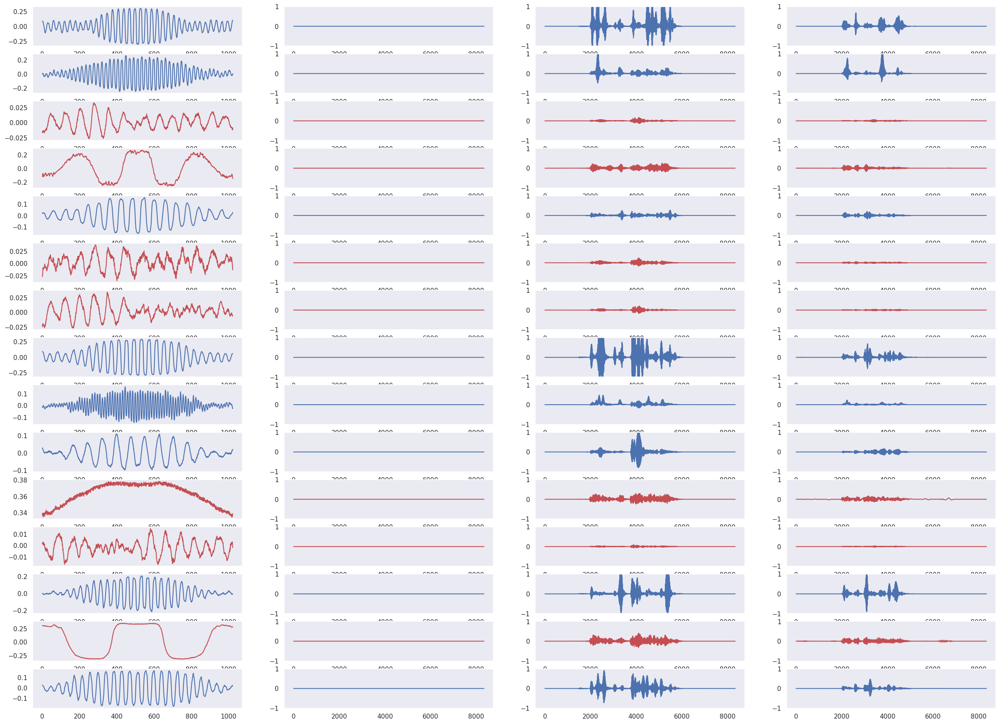

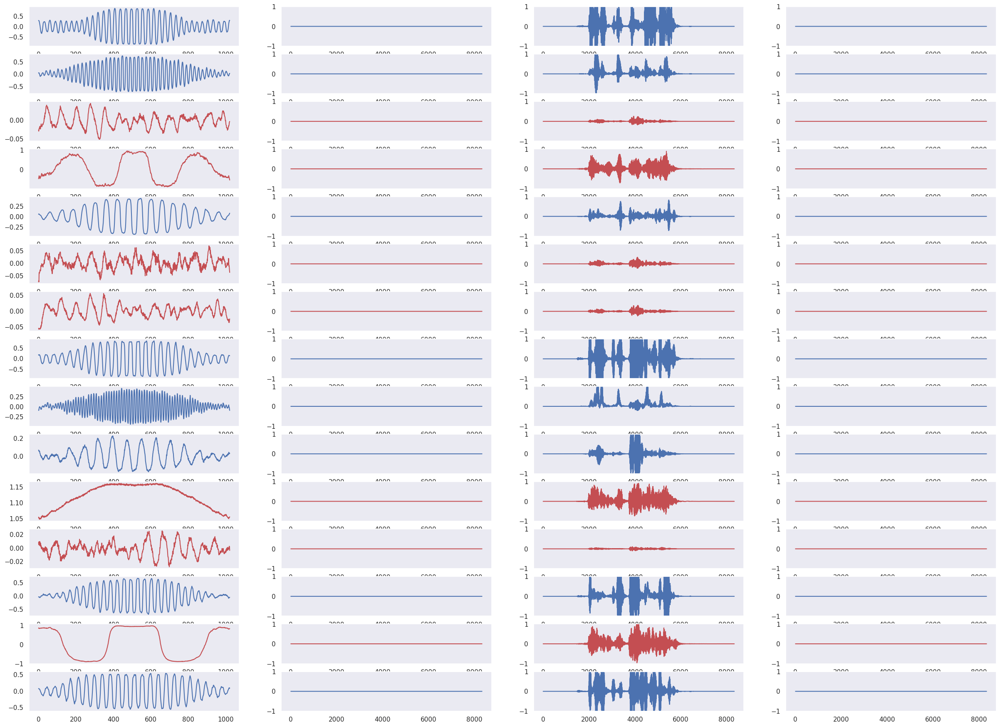

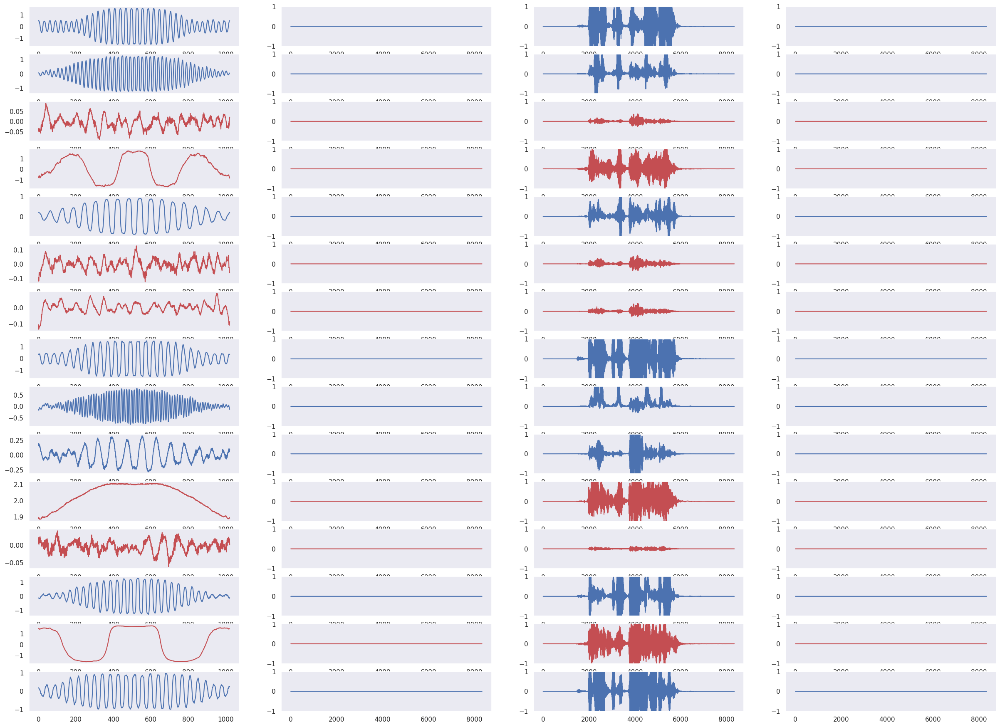

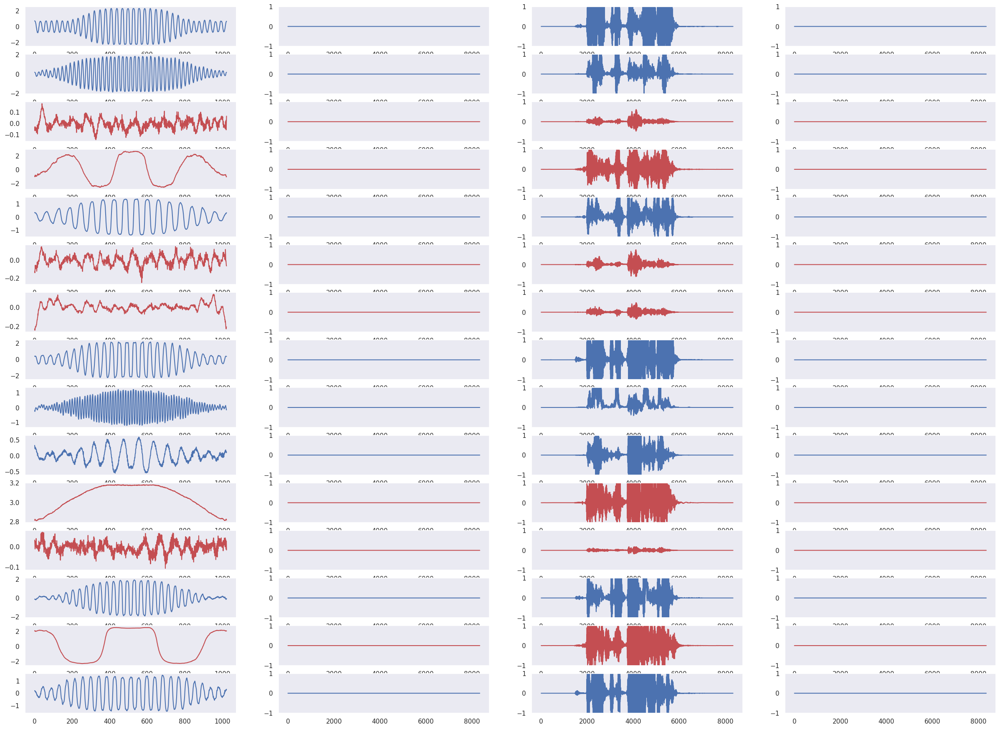

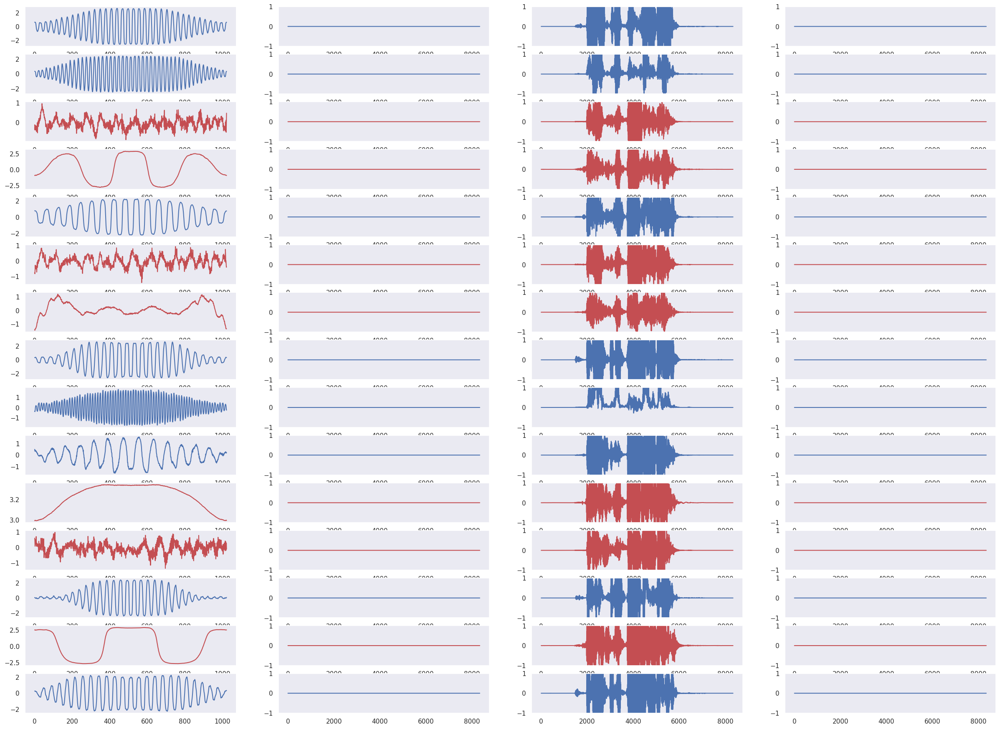

...

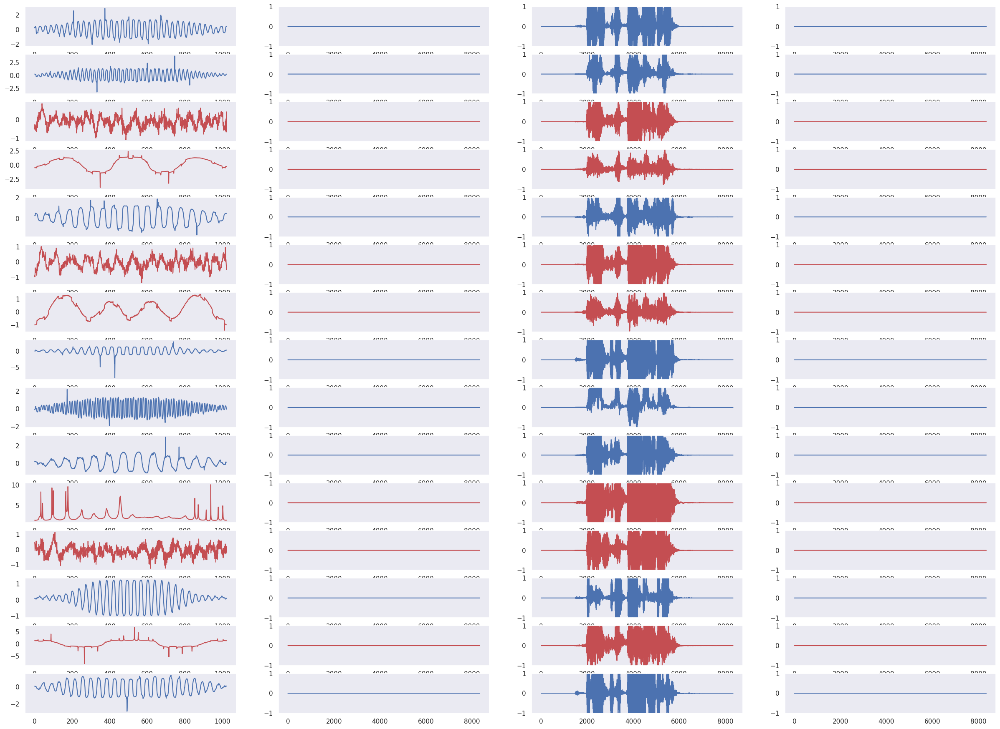

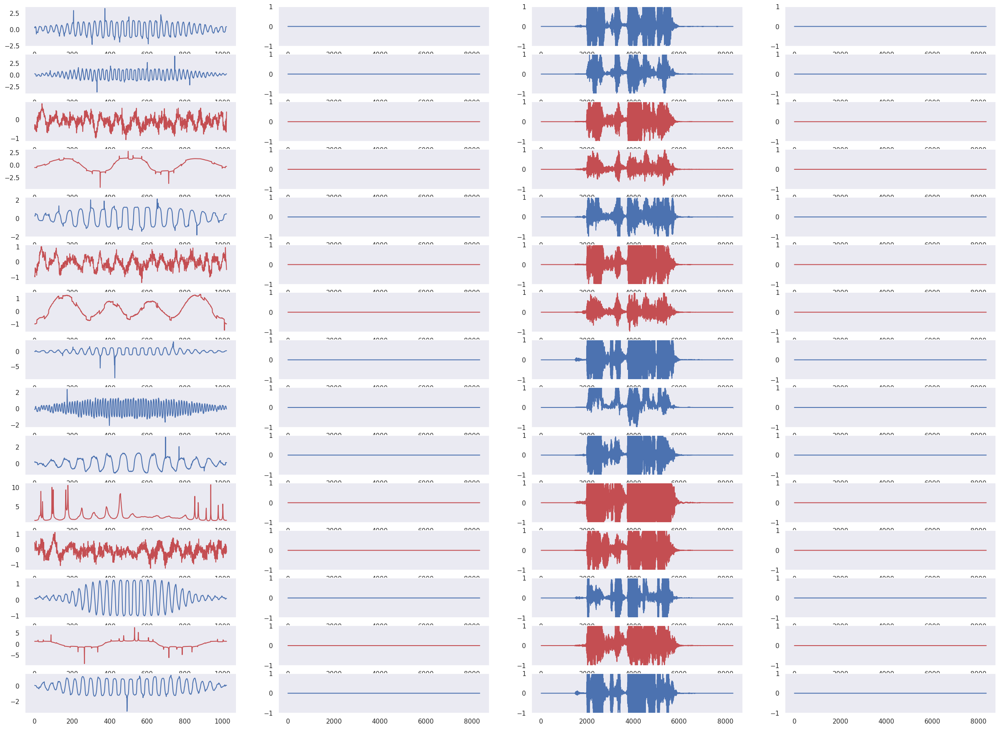

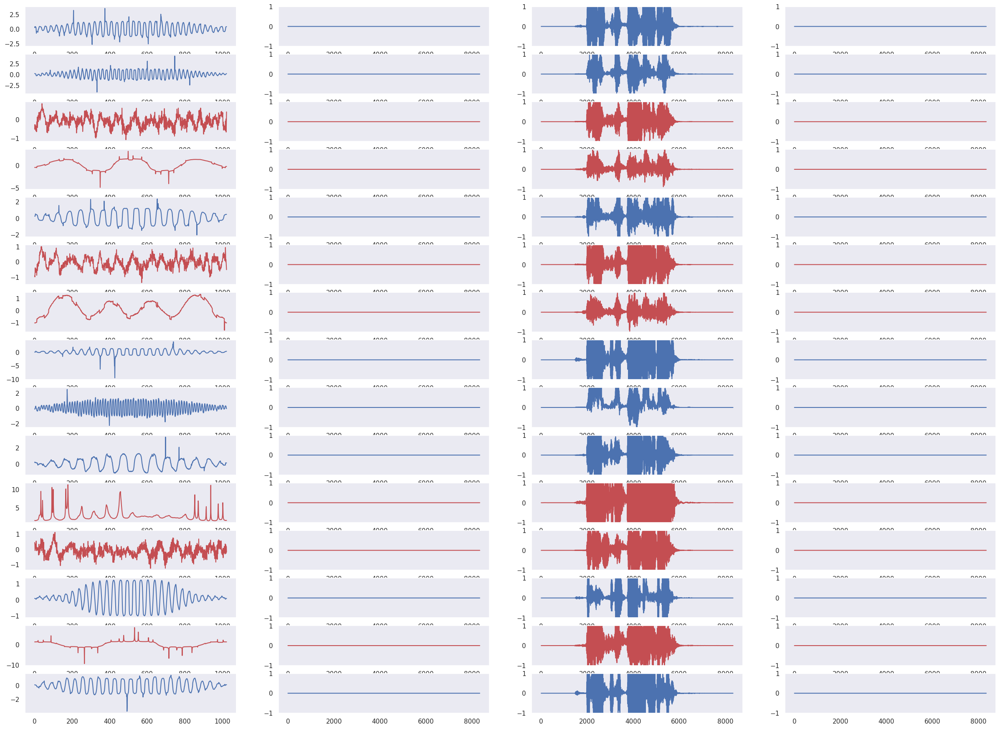

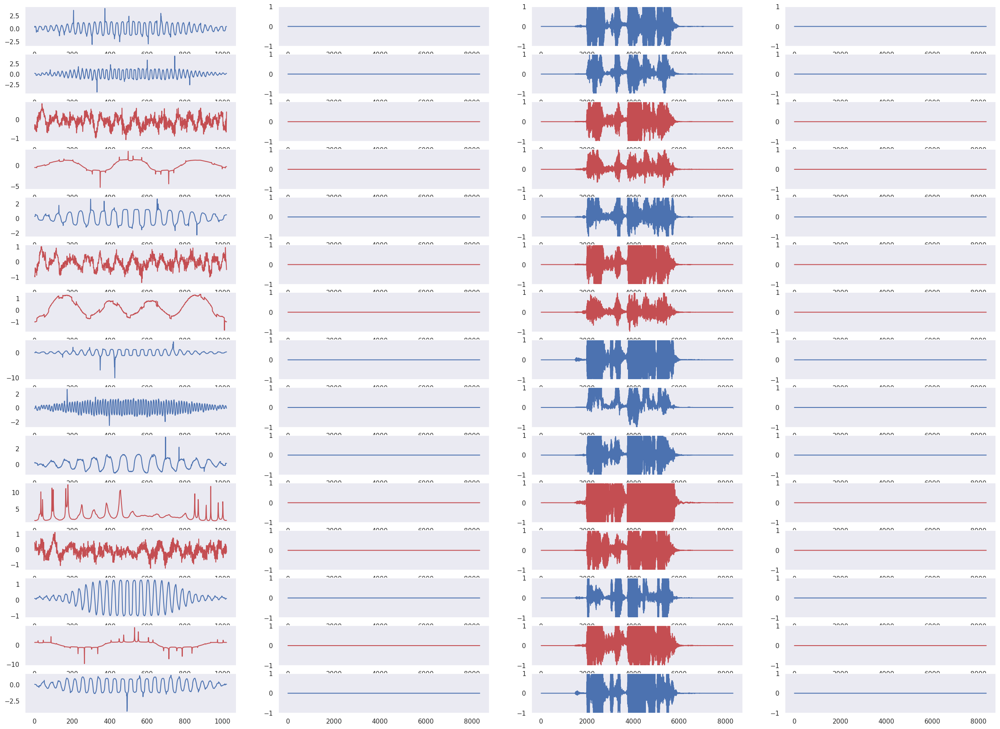

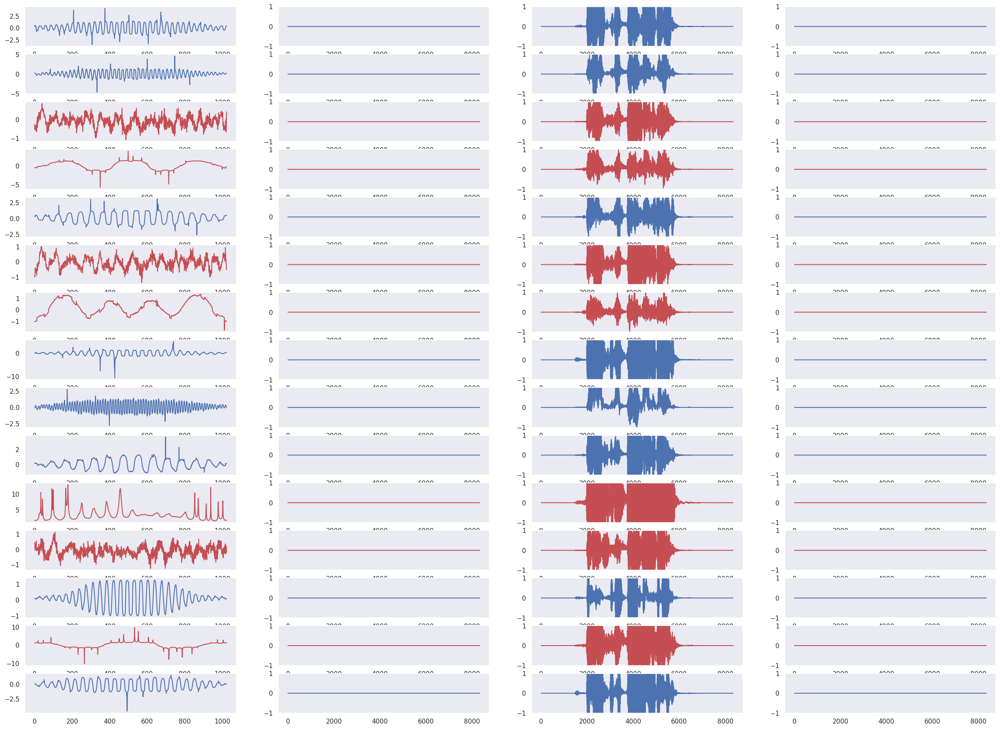

In [116]:
df.apply(
    lambda x: save_latent_plots(
        x['filename'], x['epoch'], dpi=100), axis=1)

In [119]:
df.apply(
    lambda x: save_latent_plots(
        x['filename'], x['epoch'], dpi=100), axis=1)

0      None
1      None
2      None
3      None
4      None
       ... 
96     None
97     None
98     None
99     None
100    None
Length: 101, dtype: object

In [120]:
from PIL  import Image

In [121]:
log_gif_dir = f'../scb9_models/gifs/'

In [133]:
def make_gif(img_list, out_filename, out_dir=log_gif_dir, duration=100, resize=None):
    if resize is None:
        frames = [Image.open(image) for image in img_list]
    else:
        frames = [Image.open(image).resize(resize) for image in img_list]
    frame_one = frames[0]
    frame_one.save(f'{out_dir}{out_filename}.gif', 
                   format="GIF", append_images=frames, save_all=True, duration=duration, loop=0)

In [135]:
img_list = glob.glob(f'{log_img_dir}*.png')
make_gif(img_list, 'latents', resize=(2414,1743))